In [3]:
from menu_listing.constants import PROJECT_ROOT, PID_RNAME_MAPPING
import os.path as osp
import json
import requests
from io import BytesIO
from PIL import Image
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from sklearn.metrics.pairwise import cosine_similarity

from image_generating.collage import get_all_menu_data

from vertexai.vision_models import MultiModalEmbeddingModel
mm_embedding_model = MultiModalEmbeddingModel.from_pretrained("multimodalembedding")

place_ids = [
    "ChIJO79pfG7Kj4ARTnmoiEbJKEk",
    "ChIJT2NxLBPKj4ARRivowJnL3Wg",
    "ChIJw1N0TPq1j4ARiWgSpsEurvo"
    ]

/Users/youjin/miniforge3/envs/menu/lib/python3.10/site-packages/vertexai/_model_garden/_model_garden_models.py:278: UserWarning: This feature is deprecated as of June 24, 2025 and will be removed on June 24, 2026. For details, see https://cloud.google.com/vertex-ai/generative-ai/docs/deprecations/genai-vertexai-sdk.
  warning_logs.show_deprecation_warning()


# Filter out target images

In [23]:
menu_metadata = get_all_menu_data(place_ids[1])[13]
template = """* Menu name: {name}
* Menu description from the menu board: {description}
* Appearance description based on the reviews: {appearance}
* Ingredients list: {ingredients}
"""

ingredients = []
for lst in menu_metadata['from_reviews']['ingredients_by_category'].values():
    ingredients.extend(lst)

print(template.format(name=menu_metadata['from_menuboard']['name'],
                      description=menu_metadata['from_menuboard']['description'],
                      appearance=menu_metadata['from_reviews']['appearance'],
                      ingredients=ingredients))

* Menu name: Beef Jjamppong
* Menu description from the menu board: Noodle soup with beef and vegetables in beef broth
* Appearance description based on the reviews: Noodle soup of beef and vegetables in a non-spicy broth, distinguished from other jjamppong varieties by its lack of red chili tint and the presence of beef slices instead of seafood.
* Ingredients list: ['beef']



In [ ]:
place_id = place_ids[1]

parquet_path = PROJECT_ROOT / "data" / "byproduct" / "11-embeddings" / f"{place_id}.parquet"
df = pd.read_parquet(parquet_path)
print(f"columns read: {df.columns.to_list()}\n")

with open(osp.join(PROJECT_ROOT, "data", "byproduct", "12-menu_extracted", f"{place_id}-gemini-3-flash-preview-c4-s1024.json"), "r") as f:
    data = json.load(f)

menu_data_all = dict()
for menu_data in data:
    menu_id = int(menu_data.pop("id"))
    menu_data_all[menu_id] = {
        "from_menuboard": menu_data,
        "from_reviews": []
    }

with open(osp.join(PROJECT_ROOT, "data", "byproduct", "22-menu_summaries", f"{place_id}.json"), "r") as f:
    data = json.load(f)

for menu_data in data:
    menu_id = int(menu_data.pop("id"))
    menu_data_all[menu_id]["from_reviews"] = menu_data


menu_id = 0
menu_data = menu_data_all[menu_id]

print(f"Restaurant: {PID_RNAME_MAPPING[place_id]} ({place_id})")
print(f"Menu[{menu_id}] {menu_data['from_menuboard']['name']}")
print(f"-From Menuboard-")
for k, v in menu_data["from_menuboard"].items():
    if k != "name": print(f"\t{k}: {v}")
print(f"-From Reviews-")
for k, v in menu_data["from_reviews"].items():
    print(f"\t{k}: {v}")

all_images_idx = df['review_id'].isin(menu_data['from_reviews']['relevant_review_ids'])
menu_df = df[all_images_idx & df['likely_food']].drop(columns=['likely_food', 'published_date'])
print(
    f"\n\n{len(menu_data['from_reviews']['relevant_review_ids'])} reviews mentioned <{menu_data['from_menuboard']['name']}>, found total {all_images_idx.sum()} images "
    f"where {len(menu_df)} is identified as likely food images.")

# print("\n** Filtered out images:")
# for url in df[all_images_idx&~df['likely_food']]['image_url'].to_list():
#     print(url)

images_cache = dict()
for row in df[all_images_idx][['image_url', 'likely_food', 'review_id']].itertuples():
    url, likely_food, review_id = row.image_url, row.likely_food, row.review_id 
    response = requests.get(url.replace("=s1024", "=s200"))
    img = Image.open(BytesIO(response.content)).convert("RGB")
    images_cache[url] = (img, likely_food, review_id)

columns read: ['review_id', 'image_url', 'published_date', 'embedding_128', 'likely_food']

Restaurant: Paik's Noodle / 홍콩반점 산호세 (ChIJT2NxLBPKj4ARRivowJnL3Wg)
Menu[0] Jajang Rice
-From Menuboard-
	nicknames: ['Black Bean Rice', 'Egg Omelette Rice']
	price: 14.95
	options: {'size': [], 'spiciness': [], 'toppings': [], 'proteins': [], 'other_option': []}
	description: Rice topped with egg omelette and shrimp, served in Jajang sauce, plus a small bowl of Jjamppong soup
	ingredients_by_category: {'fish': [], 'shellfish': ['shrimp'], 'red_meat': ['pork'], 'poultry': [], 'allergen_ingredients': ['egg']}
	dietary_labels: []
-From Reviews-
	relevant_review_ids: ['4', '29', '34', '54', '99', '114', '116', '161', '162', '171', '198', '204', '217', '409']
	objective_summary: A rice dish topped with an egg and shrimp omelette, served with a savory black bean sauce and a side of spicy jjamppong soup.
	appearance: Rice dish topped with a yellow egg and shrimp omelette, covered in a thick black bean 

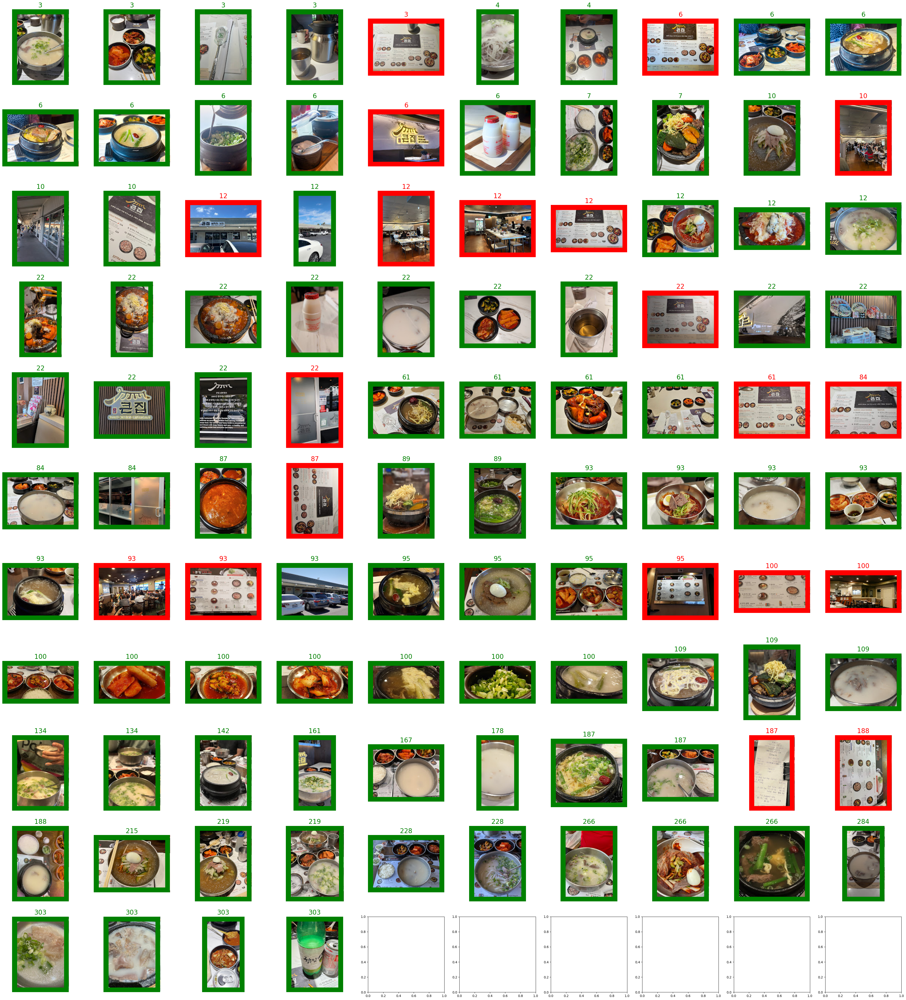

In [15]:
rows = (len(images_cache) - 1) // 10 + 1
cols = min(10, len(images_cache))
fig, axs = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows))
axs = np.atleast_1d(axs).ravel()
for ax, (img, likely_food, review_id) in zip(axs, images_cache.values()):
    ax.imshow(img)
    
    if not likely_food: color = 'r'
    else: color = 'g'
    rect = patches.Rectangle((0,0), img.width, img.height, linewidth=30, edgecolor=color, facecolor='none')
    ax.add_patch(rect)
    ax.set_title(f"{review_id}", color=color, fontsize=20)
    ax.axis('off')
plt.show()

In [16]:
query_text = menu_data['from_reviews']['appearance']
# query_text = "Cold noodles in spicy red sauce topped with marinated skate fish, cucumber, radish, korean pear, sesame seeds oil and boiled egg"
print(query_text)

EMBED_DIM = 128
query_embedding = mm_embedding_model.get_embeddings(
    contextual_text=query_text,
    dimension=EMBED_DIM
).text_embedding
query_embedding = np.array(query_embedding).reshape(1, -1)

White soup of milky, rich ox bone broth containing submerged slices of beef brisket and white noodles, served in a stone pot or bowl with a surface layer of chopped green onions.


In [32]:
# compute cosine similarity with menu_df[f"embedding_{EMBED_DIM}"] and add the similarity scores to menu_df
menu_embeddings = np.vstack(menu_df[f"embedding_{EMBED_DIM}"].to_list())
similarity_scores = cosine_similarity(menu_embeddings, query_embedding).squeeze()

menu_df['similarity'] = similarity_scores

menu_df_filtered = pd.DataFrame()
for review_id, group in menu_df.groupby('review_id'):
    topk = group.nlargest(2, 'similarity')
    menu_df_filtered = pd.concat([menu_df_filtered, topk.drop(columns=[c for c in topk.columns if c.startswith('embedding_')])], axis=0)
# menu_df_filtered

In [37]:
menu_df_filtered.sort_values(by='similarity', ascending=False).reset_index(drop=True)[:10]

,review_id,image_url,similarity
0,109,https://lh3.googleusercontent.com/geougc-cs/AM...,0.442248
1,6,https://lh3.googleusercontent.com/geougc-cs/AM...,0.438218
2,22,https://lh3.googleusercontent.com/geougc-cs/AM...,0.435145
3,303,https://lh3.googleusercontent.com/geougc-cs/AM...,0.428633
4,3,https://lh3.googleusercontent.com/geougc-cs/AM...,0.420839
5,142,https://lh3.googleusercontent.com/geougc-cs/AM...,0.420159
6,12,https://lh3.googleusercontent.com/geougc-cs/AM...,0.416984
7,284,https://lh3.googleusercontent.com/geougc-cs/AM...,0.414955
8,161,https://lh3.googleusercontent.com/geougc-cs/AM...,0.414804
9,4,https://lh3.googleusercontent.com/geougc-cs/AM...,0.412401


Menu[0] Seol Leong Tang
White soup of milky, rich ox bone broth containing submerged slices of beef brisket and white noodles, served in a stone pot or bowl with a surface layer of chopped green onions.


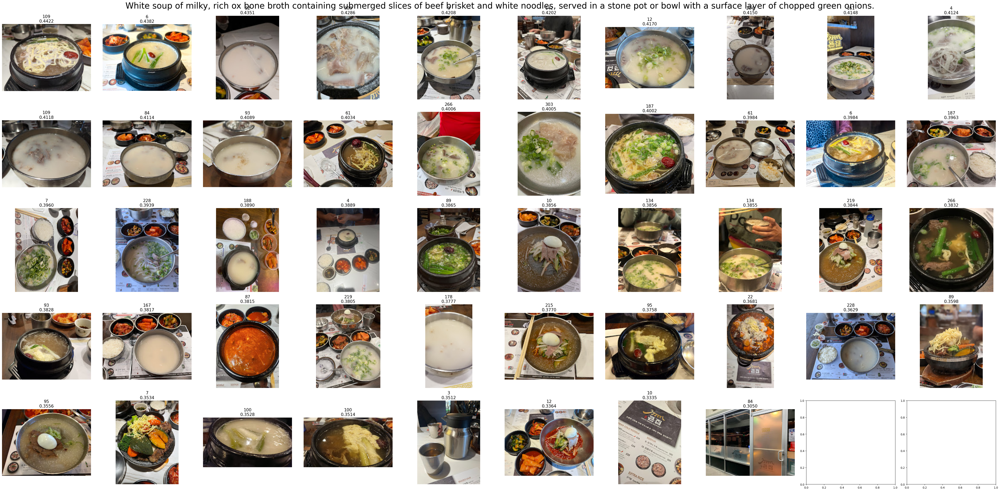

In [20]:
# plot the final images

filtered = []
for row in menu_df_filtered[['image_url', 'similarity', 'review_id', f"embedding_{EMBED_DIM}"]].itertuples():
    url, similarity, review_id = row.image_url, row.similarity, row.review_id 
    img = images_cache[url][0]
    filtered.append((similarity, img, review_id, np.array(getattr(row, f"embedding_{EMBED_DIM}"))))

filtered =list(sorted(filtered, key=lambda x: x[0], reverse=True))
print(f"Menu[{menu_id}] {menu_data['from_menuboard']['name']}")
print(query_text)

rows = (len(filtered) - 1) // 10 + 1
cols = min(10, len(filtered))
fig, axs = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows))
axs = np.atleast_1d(axs).ravel()
for ax, (similarity, img, review_id, embedding) in zip(axs, filtered):
    ax.imshow(img)
    ax.set_title(f"{review_id}\n{similarity:.4f}", fontsize=15)
    ax.axis('off')
plt.suptitle(query_text, fontsize=30)
plt.tight_layout()
plt.show()

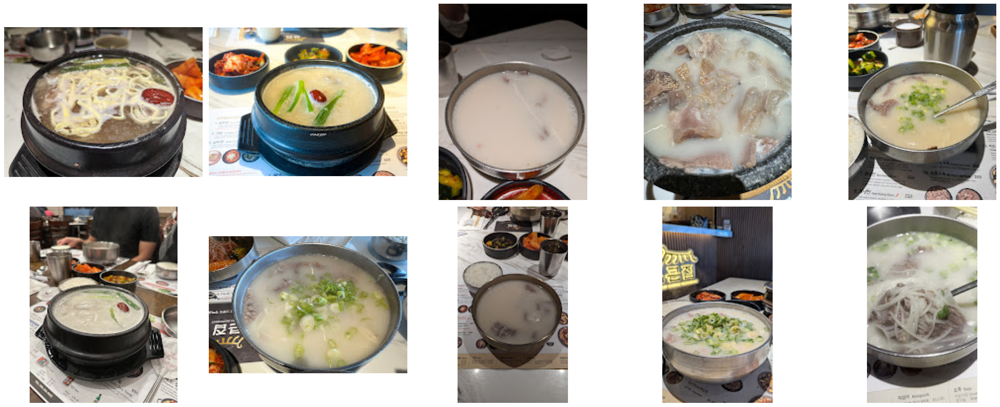

In [28]:
# collage top 10 images from `filtered` without any text
fig, axs = plt.subplots(2, 5, figsize=(25, 10))
for ax, (similarity, img, review_id, embedding) in zip(axs.flatten(), filtered[:20]):
    ax.imshow(img)
    ax.axis('off')
plt.tight_layout()

# Clustering (Deprecated)

In [185]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import normalize

(6, 128)


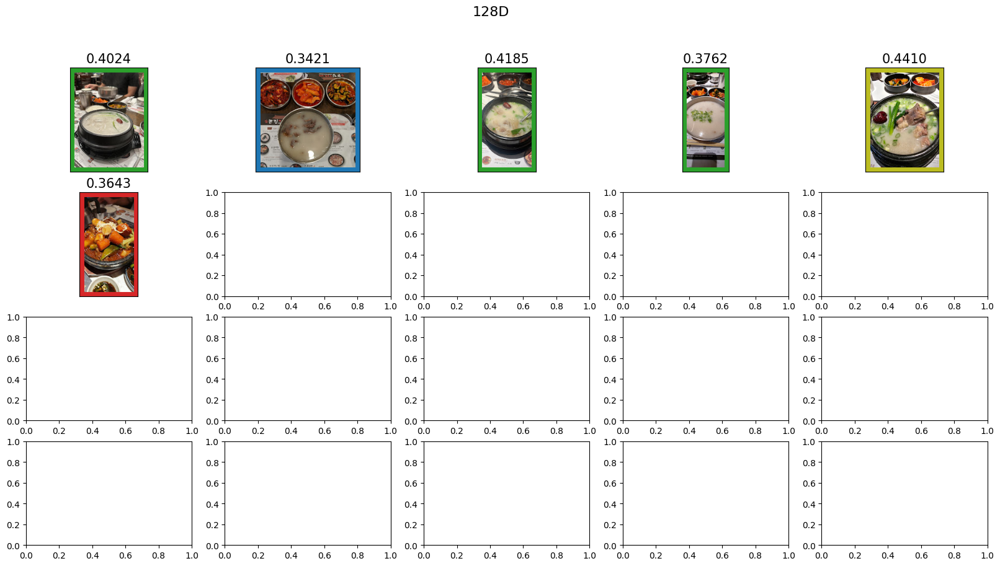

In [187]:
X = np.array(embeddings)
print(X.shape)
X_norm = normalize(X)

# cluster_model = AgglomerativeClustering(
#     n_clusters=None, 
#     distance_threshold=0.3, 
#     metric='euclidean', 
#     linkage='average'
# )
cluster_model = AgglomerativeClustering(n_clusters=4, metric='euclidean', linkage='ward')


labels = cluster_model.fit_predict(X_norm)

color_by_label = {
    0: '#2ca02c',  # tab:green
    1: '#d62728',  # tab:red
    2: '#1f77b4',  # tab:blue
    3: '#bcbd22',  # tab:olive (yellow-ish)
    4: '#ff7f0e',  # tab:orange
    5: '#9467bd',  # tab:purple
    6: '#17becf',  # tab:cyan
    7: '#e377c2',  # tab:pink
    8: '#8c564b',  # tab:brown
    9: '#7f7f7f'   # tab:gray
}
fig, axes = plt.subplots(4,5, figsize=(20,10))
for i in range(min(20, len(images))):
    ax = axes[i//5][i%5]
    ax.set_xticks([])
    ax.set_yticks([])

    img = images[i][0]
    similarity = images[i][1]
    label = labels[i]
   
    ax.imshow(img)
    rect = patches.Rectangle((0, 0), img.size[0], img.size[1], 
                         linewidth=10, edgecolor=color_by_label[label], facecolor='none')
    ax.add_patch(rect)
    ax.set_title(f"{similarity:.4f}", fontsize=15)


plt.suptitle(f"{EMBED_DIM}D", fontsize=16)
plt.show()